In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
from datetime import datetime
from dateutil import relativedelta
import warnings
warnings.filterwarnings("ignore")

# fix_yahoo_finance is used to fetch data 
import yfinance as yf
yf.pdr_override()

In [3]:
# input
# A.I. Stock
symbols = ['TCEHY','NVDA','MSFT','TWLO','AMZN','GOOGL','NFLX','CRM','DE','SPLK','VERI','SNPS','QUIK','BRN.AX']
start = '2010-01-01'
end = '2020-12-20'

In [4]:
df = pd.DataFrame()
for s in symbols:
    df[s] = yf.download(s,start,end)['Adj Close']

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


In [5]:
d1 = datetime.strptime(start, "%Y-%m-%d")
d2 = datetime.strptime(end, "%Y-%m-%d")
delta = relativedelta.relativedelta(d2,d1)
print('How many years of investing?')
print('%s years' % delta.years)

How many years of investing?
10 years


In [6]:
number_of_years = delta.years

In [7]:
days = (df.index[-1] - df.index[0]).days
days

4000

In [8]:
# show 5 result đầu tiên
df.head()

,TCEHY,NVDA,MSFT,TWLO,AMZN,GOOGL,NFLX,CRM,DE,SPLK,VERI,SNPS,QUIK,BRN.AX
Date,,,,,,,,,,,,,,
2010-01-05,4.331298,17.248186,24.113148,NaN,134.690002,312.307312,7.358572,18.625000,44.020134,NaN,NaN,22.250000,30.52,NaN
2010-01-06,4.360486,17.358511,23.965164,NaN,132.250000,304.434448,7.617143,18.592501,43.901901,NaN,NaN,22.209999,28.42,NaN
2010-01-07,4.183419,17.018332,23.715933,NaN,130.000000,297.347351,7.485714,18.510000,44.217175,NaN,NaN,22.150000,29.40,NaN
2010-01-08,4.239847,17.055109,23.879499,NaN,133.520004,301.311310,7.614286,18.537500,45.423100,NaN,NaN,22.309999,29.82,NaN
2010-01-11,4.323516,16.816057,23.575750,NaN,130.309998,300.855865,7.604286,18.412500,47.251690,NaN,NaN,22.120001,31.08,NaN


In [9]:
# show 5 result sau cùng
df.tail()

,TCEHY,NVDA,MSFT,TWLO,AMZN,GOOGL,NFLX,CRM,DE,SPLK,VERI,SNPS,QUIK,BRN.AX
Date,,,,,,,,,,,,,,
2020-12-14,73.160004,532.349976,214.199997,350.089996,3156.969971,1752.260010,522.419983,221.270004,252.720001,159.380005,28.200001,238.860001,3.11,0.355
2020-12-15,73.120003,534.419983,214.130005,345.100006,3165.120117,1761.079956,519.780029,220.149994,261.989990,161.800003,26.059999,242.740005,3.10,0.345
2020-12-16,74.059998,529.700012,219.279999,350.880005,3240.959961,1757.189941,524.830017,223.619995,261.119995,162.339996,25.610001,248.100006,3.03,0.345
2020-12-17,75.279999,533.650024,219.419998,361.070007,3236.080078,1740.510010,532.900024,225.919998,264.529999,166.259995,26.559999,250.289993,3.15,0.340
2020-12-18,75.309998,530.880005,218.589996,365.029999,3201.649902,1726.219971,534.450012,227.429993,270.700012,165.889999,25.500000,255.000000,3.38,0.325


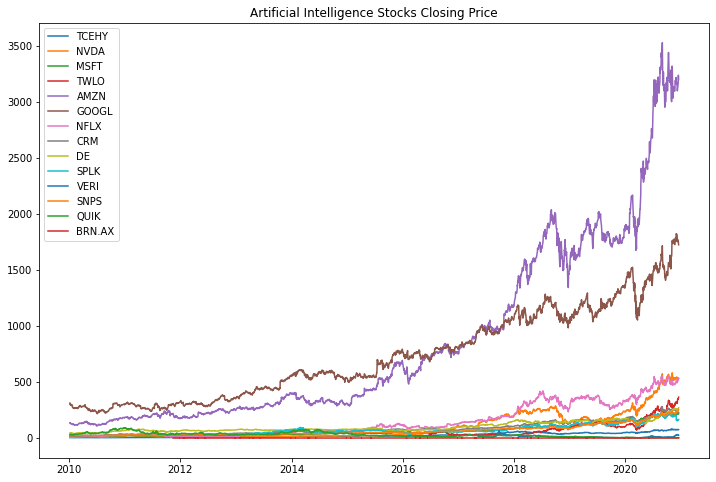

In [10]:
plt.figure(figsize=(12,8))
plt.plot(df)
plt.title('Artificial Intelligence Stocks Closing Price')
plt.legend(labels=df.columns)

In [11]:
# Normalize the data/Chuẩn hóa dữ liệu
normalize = (df - df.min())/ (df.max() - df.min())

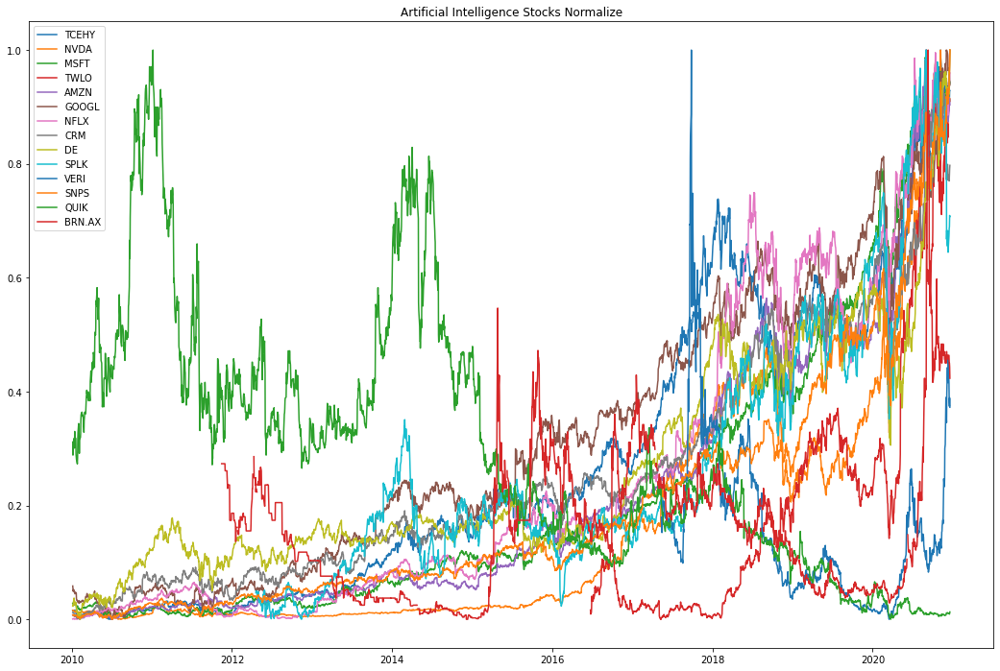

In [12]:
plt.figure(figsize=(18,12))
plt.plot(normalize)
plt.title('Artificial Intelligence Stocks Normalize')
plt.legend(labels=normalize.columns)

In [13]:
# Xét giao thoa profit
stock_rets = df.pct_change().dropna()

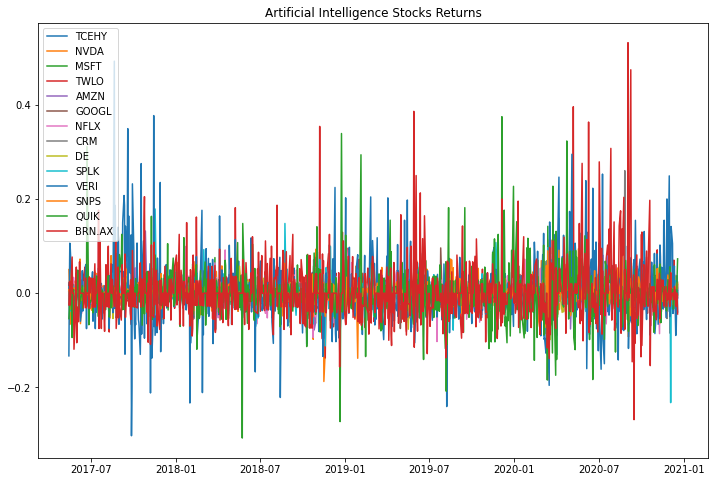

In [14]:
plt.figure(figsize=(12,8))
plt.plot(stock_rets)
plt.title('Artificial Intelligence Stocks Returns')
plt.legend(labels=stock_rets.columns)

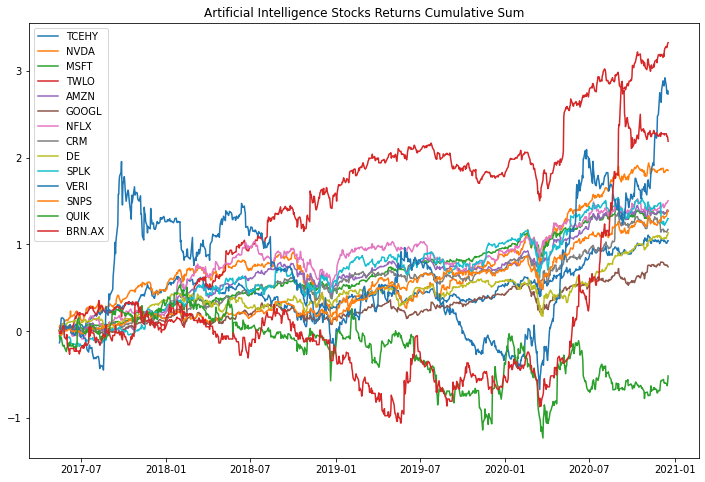

In [15]:
# Xuất tổng tích lũy 
plt.figure(figsize=(12,8))
plt.plot(stock_rets.cumsum())
plt.title('Artificial Intelligence Stocks Returns Cumulative Sum')
plt.legend(labels=stock_rets.columns)

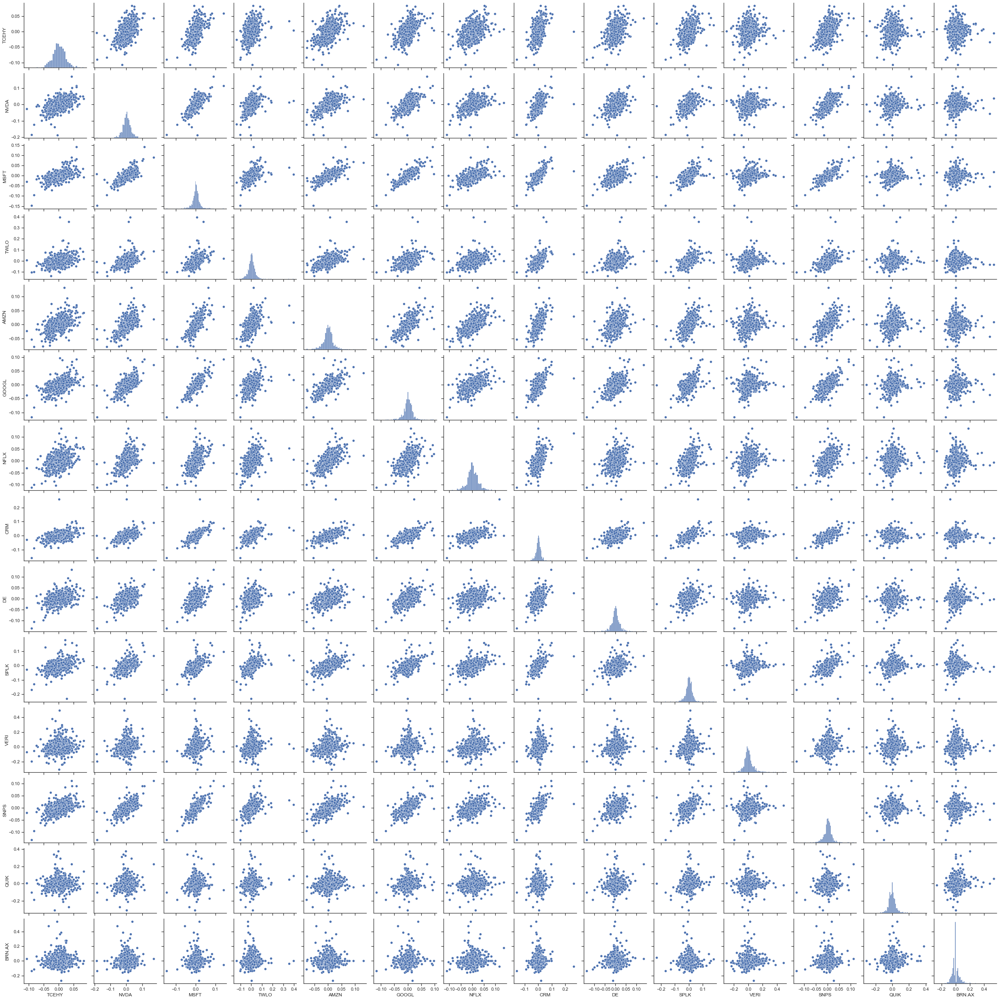

In [16]:
# Sắp xếp thuật toán K-means
sns.set(style='ticks')
ax = sns.pairplot(stock_rets, diag_kind='hist')

nplot = len(stock_rets.columns)
for i in range(nplot) :
    for j in range(nplot) :
        ax.axes[i, j].locator_params(axis='x', nbins=6, tight=True)

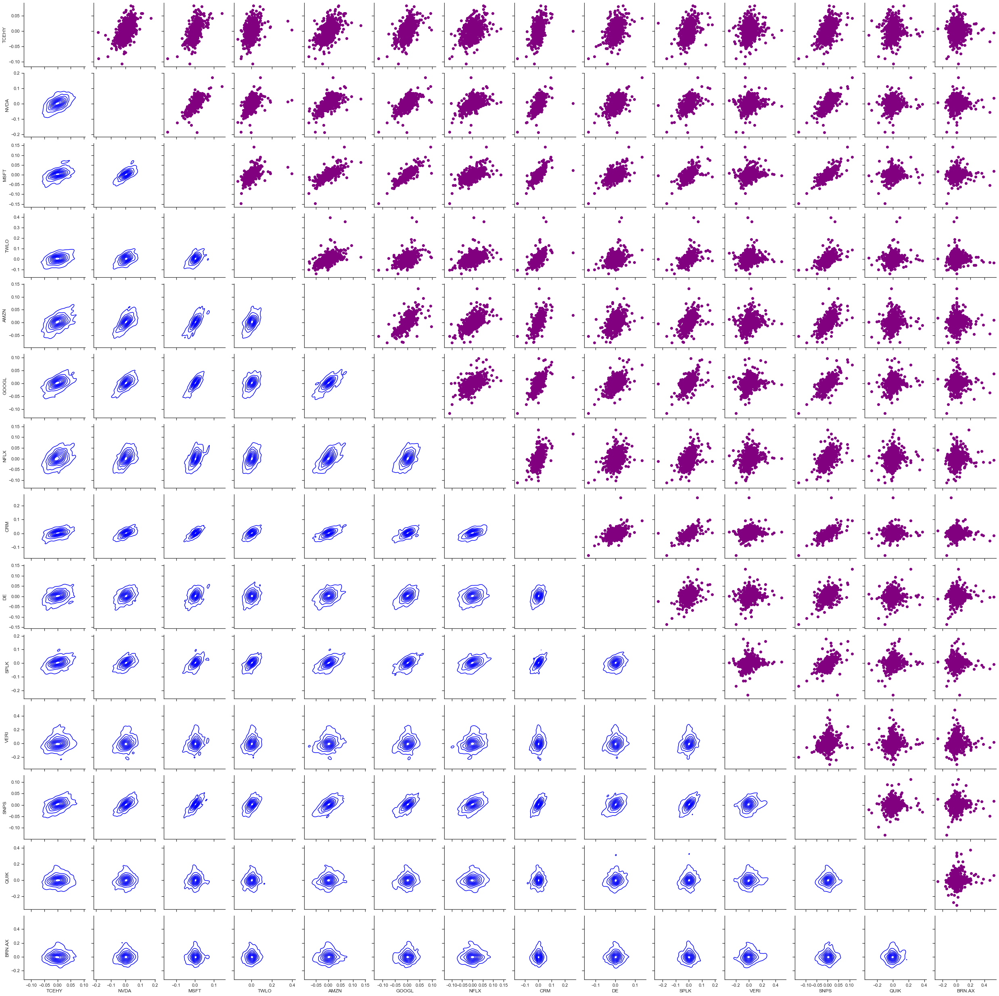

In [17]:
ax = sns.PairGrid(stock_rets)
ax.map_upper(plt.scatter, color='purple')
ax.map_lower(sns.kdeplot, color='blue')
ax.map_diag(plt.hist, bins=30)
for i in range(nplot) :
    for j in range(nplot) :
        ax.axes[i, j].locator_params(axis='x', nbins=6, tight=True)

<AxesSubplot:>

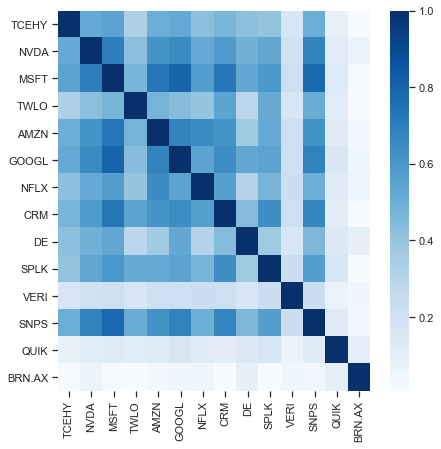

In [18]:
# mô hình dự đoán compare prof between comp
plt.figure(figsize=(7,7))
corr = stock_rets.corr()

# plot the heatmap
sns.heatmap(corr, 
        xticklabels=corr.columns,
        yticklabels=corr.columns,
            cmap="Blues")

<AxesSubplot:>

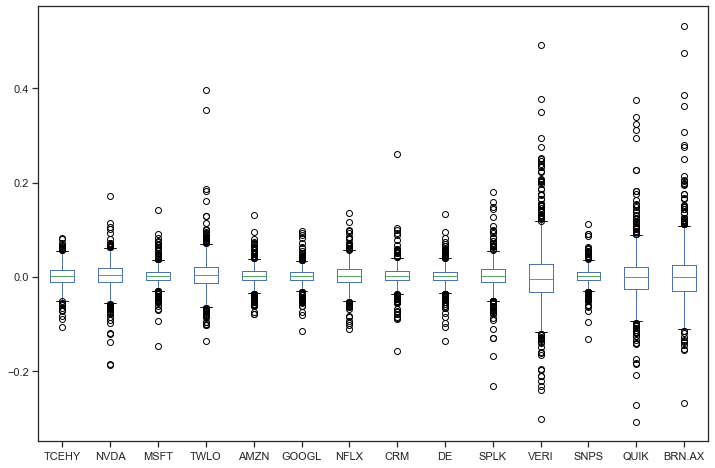

In [19]:
# Box plot
stock_rets.plot(kind='box',figsize=(12,8))

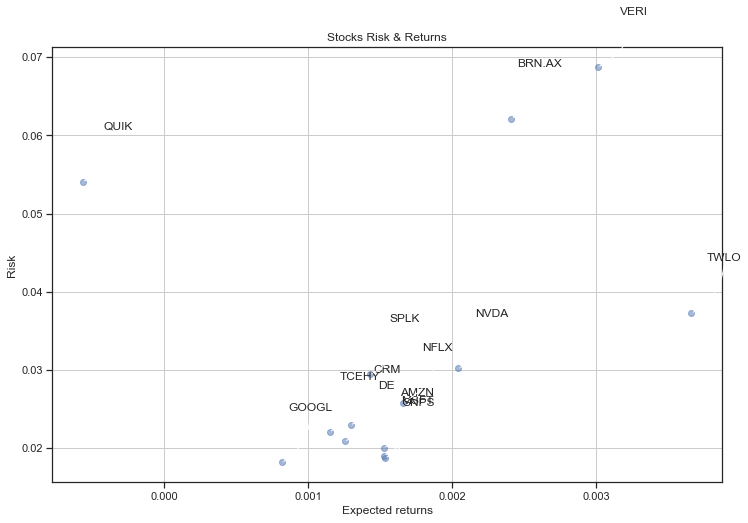

In [20]:
rets = stock_rets.dropna()

plt.figure(figsize=(12,8))
plt.scatter(rets.mean(), rets.std(),alpha = 0.5)

plt.title('Stocks Risk & Returns')
plt.xlabel('Expected returns')
plt.ylabel('Risk')
plt.grid(which='major')

for label, x, y in zip(rets.columns, rets.mean(), rets.std()):
    plt.annotate(
        label, 
        xy = (x, y), xytext = (50, 50),
        textcoords = 'offset points', ha = 'right', va = 'bottom',
        arrowprops = dict(arrowstyle = '-', connectionstyle = 'arc3,rad=-0.3'))

In [22]:
# Chuẩn hóa giá trị trả về
Normalized_Value = ((rets[:] - rets[:].min()) /(rets[:].max() - rets[:].min()))
Normalized_Value.head()

,TCEHY,NVDA,MSFT,TWLO,AMZN,GOOGL,NFLX,CRM,DE,SPLK,VERI,SNPS,QUIK,BRN.AX
Date,,,,,,,,,,,,,,
2017-05-15,0.604206,0.662053,0.511541,0.281216,0.358138,0.567474,0.431383,0.399253,0.527217,0.598314,0.213241,0.570525,0.371527,0.304225
2017-05-16,0.543056,0.574099,0.578555,0.302514,0.414771,0.573814,0.435842,0.377570,0.537180,0.583989,0.397156,0.549526,0.398390,0.335437
2017-05-17,0.541202,0.337256,0.412986,0.252526,0.270419,0.437925,0.293457,0.328148,0.453886,0.471559,0.514054,0.446894,0.450704,0.367450
2017-05-18,0.673672,0.638910,0.520787,0.224571,0.443521,0.588974,0.517400,0.376455,0.486258,0.533180,0.499247,0.402798,0.450704,0.304225
2017-05-19,0.680667,0.586577,0.507996,0.318530,0.381434,0.567919,0.485634,0.369386,0.775449,0.588202,0.470014,0.544242,0.483255,0.335437


In [23]:
Normalized_Value.corr()

,TCEHY,NVDA,MSFT,TWLO,AMZN,GOOGL,NFLX,CRM,DE,SPLK,VERI,SNPS,QUIK,BRN.AX
TCEHY,1.000000,0.522085,0.551755,0.334891,0.501547,0.519113,0.429673,0.467826,0.424920,0.409986,0.173008,0.505818,0.086735,0.013015
NVDA,0.522085,1.000000,0.700273,0.427405,0.617306,0.652084,0.522320,0.585896,0.489049,0.533813,0.204155,0.688746,0.120386,0.065035
MSFT,0.551755,0.700273,1.000000,0.474180,0.733393,0.801942,0.574405,0.728158,0.529514,0.598801,0.221617,0.782025,0.135516,0.017016
TWLO,0.334891,0.427405,0.474180,1.000000,0.478558,0.436561,0.399950,0.544909,0.287210,0.518485,0.169286,0.509240,0.121417,0.010358
AMZN,0.501547,0.617306,0.733393,0.478558,1.000000,0.683514,0.649954,0.613019,0.372311,0.522552,0.220595,0.625504,0.126304,0.030126
GOOGL,0.519113,0.652084,0.801942,0.436561,0.683514,1.000000,0.546364,0.644640,0.527313,0.552697,0.217344,0.687351,0.160384,0.045102
NFLX,0.429673,0.522320,0.574405,0.399950,0.649954,0.546364,1.000000,0.567471,0.312017,0.470222,0.227938,0.500501,0.128662,0.053114
CRM,0.467826,0.585896,0.728158,0.544909,0.613019,0.644640,0.567471,1.000000,0.440003,0.643095,0.216835,0.675831,0.115210,0.007099
DE,0.424920,0.489049,0.529514,0.287210,0.372311,0.527313,0.312017,0.440003,1.000000,0.377979,0.168348,0.459666,0.140086,0.095971
SPLK,0.409986,0.533813,0.598801,0.518485,0.522552,0.552697,0.470222,0.643095,0.377979,1.000000,0.229506,0.574162,0.170256,0.009197


In [25]:
# Xuất ra các dữ liệu cần xem
print("Stock returns: ")
print(rets.mean())
print('-' * 50)
print("Stock risks:")
print(rets.std())

Stock returns: 
TCEHY     0.001149
NVDA      0.002042
MSFT      0.001526
TWLO      0.003661
AMZN      0.001526
GOOGL     0.000817
NFLX      0.001656
CRM       0.001293
DE        0.001251
SPLK      0.001429
VERI      0.003011
SNPS      0.001533
QUIK     -0.000567
BRN.AX    0.002411
dtype: float64
--------------------------------------------------
Stock risks:
TCEHY     0.022071
NVDA      0.030184
MSFT      0.019016
TWLO      0.037263
AMZN      0.020041
GOOGL     0.018153
NFLX      0.025823
CRM       0.022948
DE        0.020871
SPLK      0.029421
VERI      0.068740
SNPS      0.018717
QUIK      0.054071
BRN.AX    0.062149
dtype: float64


In [21]:
rest_rets = rets.corr()
pair_value = rest_rets.abs().unstack()
pair_value.sort_values(ascending = False)

BRN.AX  BRN.AX    1.000000
QUIK    QUIK      1.000000
NVDA    NVDA      1.000000
MSFT    MSFT      1.000000
TWLO    TWLO      1.000000
                    ...   
BRN.AX  TWLO      0.010358
SPLK    BRN.AX    0.009197
BRN.AX  SPLK      0.009197
        CRM       0.007099
CRM     BRN.AX    0.007099
Length: 196, dtype: float64

In [24]:
normalized_rets = Normalized_Value.corr()
normalized_pair_value = normalized_rets.abs().unstack()
normalized_pair_value.sort_values(ascending = False)

BRN.AX  BRN.AX    1.000000
QUIK    QUIK      1.000000
NVDA    NVDA      1.000000
MSFT    MSFT      1.000000
TWLO    TWLO      1.000000
                    ...   
BRN.AX  TWLO      0.010358
SPLK    BRN.AX    0.009197
BRN.AX  SPLK      0.009197
        CRM       0.007099
CRM     BRN.AX    0.007099
Length: 196, dtype: float64

In [27]:
table = pd.DataFrame()
table['Returns'] = rets.mean()
table['Risk'] = rets.std()
table.sort_values(by='Returns')

,Returns,Risk
QUIK,-0.000567,0.054071
GOOGL,0.000817,0.018153
TCEHY,0.001149,0.022071
DE,0.001251,0.020871
CRM,0.001293,0.022948
SPLK,0.001429,0.029421
AMZN,0.001526,0.020041
MSFT,0.001526,0.019016
SNPS,0.001533,0.018717
NFLX,0.001656,0.025823


In [28]:
rf = 0.01
table['Sharpe Ratio'] = (table['Returns'] - rf) / table['Risk']
table

,Returns,Risk,Sharpe Ratio
TCEHY,0.001149,0.022071,-0.401049
NVDA,0.002042,0.030184,-0.263651
MSFT,0.001526,0.019016,-0.445622
TWLO,0.003661,0.037263,-0.170106
AMZN,0.001526,0.020041,-0.422850
GOOGL,0.000817,0.018153,-0.505861
NFLX,0.001656,0.025823,-0.323121
CRM,0.001293,0.022948,-0.379419
DE,0.001251,0.020871,-0.419170
SPLK,0.001429,0.029421,-0.291310
